In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import shapefile
import pickle
import os

# load data

## load uav data

In [2]:
uav_data21 = pd.read_excel("out/2021_props_all.xlsx")
uav_data21

,date,label,area,convex_area,eccentricity,equivalent_diameter,major_axis_length,minor_axis_length,min_area_rect_max,min_area_rect_min,perimeter,circularity
0,20210512,285,2371,2529,0.485232,54.944071,59.213990,51.775862,55.720016,54.447224,197.438600,0.764324
1,20210512,287,2133,2470,0.537675,52.113529,58.738901,49.525839,58.420361,50.606167,207.515765,0.622441
2,20210512,290,3064,3156,0.436804,62.459635,66.183537,59.535859,63.639610,60.062481,215.823376,0.826612
3,20210512,143,2201,2310,0.507040,52.937701,57.594992,49.642407,54.708408,50.472454,186.610173,0.794254
4,20210512,144,2473,2582,0.654588,56.113469,65.209004,49.297071,63.243076,47.292389,200.852814,0.770332
...,...,...,...,...,...,...,...,...,...,...,...,...
19216,20210526,3292,35864,37599,0.525166,213.690110,233.923807,199.069049,229.692520,195.691391,773.050865,0.754141
19217,20210526,3289,12296,13003,0.612709,125.122953,143.472000,113.387209,133.205338,125.509468,456.132034,0.742664
19218,20210526,3290,5646,14470,0.921993,84.786263,240.935196,93.291666,223.077530,98.535194,625.428499,0.181383
19219,20210526,3291,21634,25898,0.875148,165.967660,251.979194,121.921665,235.728485,135.437225,681.026479,0.586163


In [3]:
uav_data21_draw = uav_data21[['date', 'label', 'major_axis_length']]
uav_data21_draw

,date,label,major_axis_length
0,20210512,285,59.213990
1,20210512,287,58.738901
2,20210512,290,66.183537
3,20210512,143,57.594992
4,20210512,144,65.209004
...,...,...,...
19216,20210526,3292,233.923807
19217,20210526,3289,143.472000
19218,20210526,3290,240.935196
19219,20210526,3291,251.979194


In [4]:
uav_data20 = pd.read_excel("out/2020_props_all.xlsx")
uav_data20_draw = uav_data20[['date', 'label', 'major_axis_length']]
uav_data20_draw

,date,label,major_axis_length
0,20200520,292,54.129544
1,20200520,1,73.503186
2,20200520,148,87.082156
3,20200520,293,85.785056
4,20200520,2,80.426928
...,...,...,...
42966,20200518,7119,84.382969
42967,20200518,7409,78.645916
42968,20200518,7265,90.749086
42969,20200518,7410,85.528132


## load location data

In [5]:
if os.path.exists('out/heatmap.pkl'):
    with open('out/heatmap.pkl', 'rb') as handle:
        uav_data20_merge, uav_data21_merge = pickle.load(handle)

In [6]:
if not os.path.exists('out/heatmap.pkl'):
    shp_path = r"E:\2021_tanashi_broccoli\12_locate_by_yolo\sorted_id.shp"

    shp = shapefile.Reader(str(shp_path), encoding="utf-8")

    shp_pd = pd.DataFrame(columns=["label", "x", "y"])
    for i, shape in enumerate(shp.shapes()):
        shape_id = int(shp.records()[i][0])
        x, y = shape.points[0]
        shp_pd.loc[i] = [shape_id, x, y]

    shp_pd.x -= shp_pd.x.min()
    shp_pd.y -= shp_pd.y.min()

    uav_data21_merge = pd.merge(uav_data21_draw, shp_pd, on="label")

In [7]:
uav_data21_merge

,date,label,major_axis_length,x,y
0,20210512,285,59.213990,1.512040,49.992080
1,20210514,285,79.395531,1.512040,49.992080
2,20210515,285,87.950560,1.512040,49.992080
3,20210519,285,139.130930,1.512040,49.992080
4,20210520,285,144.629077,1.512040,49.992080
...,...,...,...,...,...
19216,20210526,2015,117.143445,15.441760,29.091320
19217,20210526,1810,97.845494,19.388720,2.195960
19218,20210526,3082,170.052081,17.575920,45.991560
19219,20210526,3513,137.165555,20.497000,41.999280


In [8]:
date21 = uav_data21_merge.date.unique()
date21

array([20210512, 20210514, 20210515, 20210519, 20210520, 20210526],
      dtype=int64)

In [9]:
# 20 data
if not os.path.exists('out/heatmap.pkl'):
    shp_path = r"Z:\hwang_Pro\data\2020_tanashi_broccoli\10_locate_by_cv\color_label_0417_mavic\keep_points_manual.shp"
    shp = shapefile.Reader(str(shp_path), encoding="utf-8")

    # load points

    shp_pd20_list = []
    for i, shape in enumerate(shp.shapes()):
        shape_id = int(shp.records()[i][0])
        x, y = shape.points[0]
        shp_pd20_list.append([shape_id, x, y])

    shp_pd20 = pd.DataFrame(shp_pd20_list, columns=["label", "x", "y"])

    shp_pd20.x -= shp_pd20.x.min()
    shp_pd20.y -= shp_pd20.y.min()


    uav_data20_merge = pd.merge(uav_data20_draw, shp_pd20, on="label")

In [10]:
uav_data20_merge

,date,label,major_axis_length,x,y
0,20200520,292,54.129544,1.362130,49.618855
1,20200522,292,59.108262,1.362130,49.618855
2,20200525,292,90.267259,1.362130,49.618855
3,20200526,292,86.833583,1.362130,49.618855
4,20200528,292,104.588723,1.362130,49.618855
...,...,...,...,...,...
42966,20200518,6101,94.817478,40.385400,7.329025
42967,20200518,6371,126.428148,40.662930,14.294390
42968,20200518,6686,77.598572,43.892805,7.480550
42969,20200518,7329,57.000533,41.619930,35.517460


In [11]:
if not os.path.exists('out/heatmap.pkl'):
    with open('out/heatmap.pkl', 'wb') as handle:
        pickle.dump([uav_data20_merge, uav_data21_merge], handle, protocol=pickle.HIGHEST_PROTOCOL)

In [12]:
date20 = np.sort(uav_data20_merge.date.unique())
date20

array([20200518, 20200520, 20200522, 20200525, 20200526, 20200528],
      dtype=int64)

In [13]:
date20

array([20200518, 20200520, 20200522, 20200525, 20200526, 20200528],
      dtype=int64)

In [14]:
uav_data21_merge.major_axis_length.max(), uav_data20_merge.major_axis_length.max()

(320.7296625739552, 251.3335030064161)

In [15]:
uav_data21_merge.major_axis_length.min(), uav_data20_merge.major_axis_length.min()

(0.0, 0.0)

In [16]:
uav_data21_merge_clear = uav_data21_merge.drop(np.where(uav_data21_merge.major_axis_length == 0)[0], axis=0)
uav_data21_merge_clear

,date,label,major_axis_length,x,y
0,20210512,285,59.213990,1.512040,49.992080
1,20210514,285,79.395531,1.512040,49.992080
2,20210515,285,87.950560,1.512040,49.992080
3,20210519,285,139.130930,1.512040,49.992080
4,20210520,285,144.629077,1.512040,49.992080
...,...,...,...,...,...
19216,20210526,2015,117.143445,15.441760,29.091320
19217,20210526,1810,97.845494,19.388720,2.195960
19218,20210526,3082,170.052081,17.575920,45.991560
19219,20210526,3513,137.165555,20.497000,41.999280


In [17]:
uav_data20_merge_clear = uav_data20_merge.drop(np.where(uav_data20_merge.major_axis_length == 0)[0], axis=0)
uav_data20_merge_clear

,date,label,major_axis_length,x,y
0,20200520,292,54.129544,1.362130,49.618855
1,20200522,292,59.108262,1.362130,49.618855
2,20200525,292,90.267259,1.362130,49.618855
3,20200526,292,86.833583,1.362130,49.618855
4,20200528,292,104.588723,1.362130,49.618855
...,...,...,...,...,...
42966,20200518,6101,94.817478,40.385400,7.329025
42967,20200518,6371,126.428148,40.662930,14.294390
42968,20200518,6686,77.598572,43.892805,7.480550
42969,20200518,7329,57.000533,41.619930,35.517460


In [18]:
uav_data21_merge_clear.major_axis_length.min(), uav_data20_merge_clear.major_axis_length.min()

(46.77639122497734, 27.55737027976215)

In [19]:
uav_data20_merge_clear.x.max(), uav_data20_merge_clear.y.max(), uav_data21_merge_clear.x.max(), uav_data21_merge_clear.y.max()

(48.10360499995295, 56.515635000076145, 28.741119999962393, 53.19332000007853)

Test plot

In [20]:
test_uav = uav_data21_merge[uav_data21_merge.date==date21[0]]
test_uav

,date,label,major_axis_length,x,y
0,20210512,285,59.213990,1.51204,49.99208
6,20210512,287,58.738901,1.57384,49.62128
12,20210512,290,66.183537,1.73864,48.93736
18,20210512,143,57.594992,0.79516,49.67896
24,20210512,144,65.209004,0.90640,49.33288
...,...,...,...,...,...
18233,20210512,3480,72.353176,27.99952,4.23536
18239,20210512,3338,86.880141,27.14256,5.02228
18245,20210512,3339,118.779957,27.22496,4.67208
18251,20210512,3340,76.338104,27.25380,4.33836


In [21]:
step = 0.5
levels = np.arange(0., 32.5, step)
levels

array([ 0. ,  0.5,  1. ,  1.5,  2. ,  2.5,  3. ,  3.5,  4. ,  4.5,  5. ,
        5.5,  6. ,  6.5,  7. ,  7.5,  8. ,  8.5,  9. ,  9.5, 10. , 10.5,
       11. , 11.5, 12. , 12.5, 13. , 13.5, 14. , 14.5, 15. , 15.5, 16. ,
       16.5, 17. , 17.5, 18. , 18.5, 19. , 19.5, 20. , 20.5, 21. , 21.5,
       22. , 22.5, 23. , 23.5, 24. , 24.5, 25. , 25.5, 26. , 26.5, 27. ,
       27.5, 28. , 28.5, 29. , 29.5, 30. , 30.5, 31. , 31.5, 32. ])

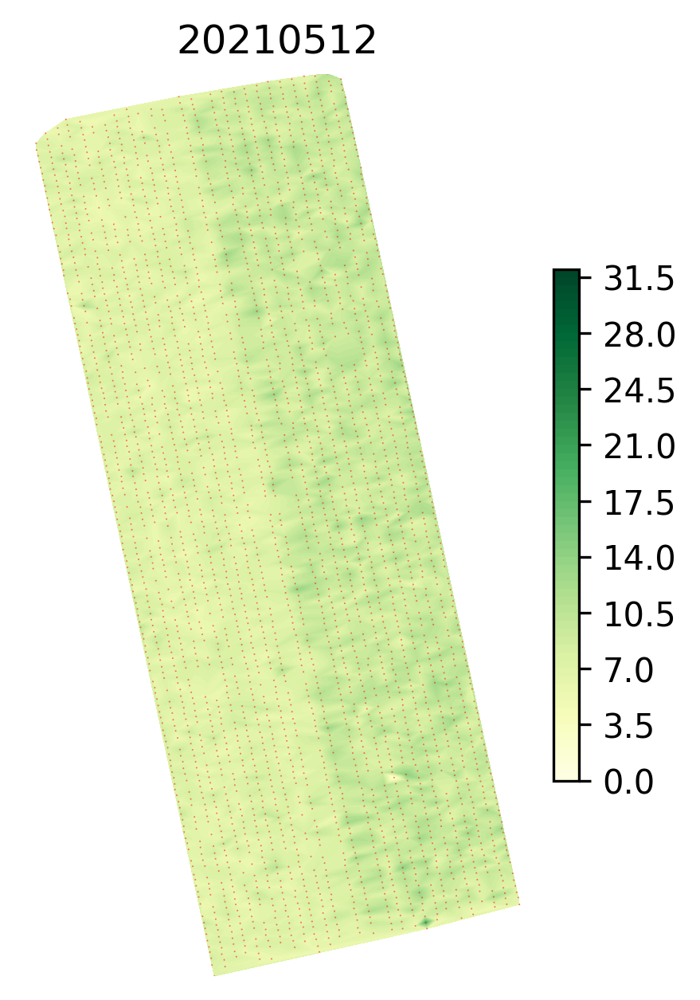

In [22]:
fig, ax = plt.subplots(1,1, figsize=(3,5), dpi=300)

cs = ax.tricontourf(test_uav.x, test_uav.y, test_uav.major_axis_length/10, levels=levels, cmap="YlGn")
ax.scatter(test_uav.x, test_uav.y, marker='.', color='r', s=1, alpha=0.5, edgecolors='None')

ax.axis('equal')
ax.axis('off')
ax.set_title(date21[0])
plt.colorbar(cs, fraction=0.046, pad=0.04)
plt.show()

Refine

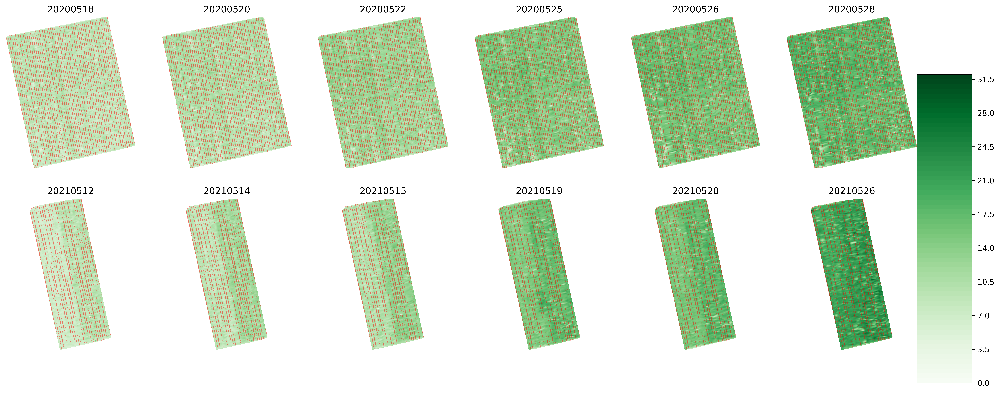

In [23]:
fig, ax = plt.subplots(2,6, figsize=(20,8), dpi=600)

for i, d in enumerate(date20):
    test_uav = uav_data20_merge[uav_data20_merge.date==d]

    cs = ax[0, i].tricontourf(test_uav.x, test_uav.y, test_uav.major_axis_length/10, levels=levels, cmap="Greens")
    ax[0, i].scatter(test_uav.x, test_uav.y, marker='.', color='r', s=3, alpha=0.5, edgecolors='None')

    ax[0, i].axis('equal')
    ax[0, i].axis('off')
    ax[0, i].set_title(d)

for i, d in enumerate(date21):
    test_uav = uav_data21_merge[uav_data21_merge.date==d]

    cs = ax[1, i].tricontourf(test_uav.x, test_uav.y, test_uav.major_axis_length/10, levels=levels, cmap="Greens")
    ax[1, i].scatter(test_uav.x, test_uav.y, marker='.', color='r', s=3, alpha=0.5, edgecolors='None')

    ax[1, i].axis('equal')
    ax[1, i].axis('off')
    ax[1, i].set_title(d)

fig.subplots_adjust(right=0.95)
cbar_ax = fig.add_axes([0.95, 0.05, 0.05, 0.7])
fig.colorbar(cs, cax=cbar_ax)

plt.show()

In [24]:
import math

In [25]:
fig, ax = plt.subplots(2,6, figsize=(20,8), dpi=600)

# rotate 12 degrees
ox, oy = 0, 0
angle = math.radians(-12)

for i, d in enumerate(date20):
    test_uav = uav_data20_merge[uav_data20_merge.date==d]

    qx = ox + math.cos(angle) * (test_uav.x - ox) - math.sin(angle) * (test_uav.y - oy)
    qy = oy + math.sin(angle) * (test_uav.x - ox) + math.cos(angle) * (test_uav.y - oy)

    ax[0, i].scatter(qx, qy, marker='.', c=test_uav.major_axis_length/10, s=20, edgecolors='None', cmap="gist_heat_r", vmin=0, vmax=32)

    ax[0, i].axis('equal')
    ax[0, i].axis('off')
    ax[0, i].set_title(d)

for i, d in enumerate(date21):
    test_uav = uav_data21_merge[uav_data21_merge.date==d]

    qx = ox + math.cos(angle) * (test_uav.x - ox) - math.sin(angle) * (test_uav.y - oy)
    qy = oy + math.sin(angle) * (test_uav.x - ox) + math.cos(angle) * (test_uav.y - oy)
    
    cs = ax[1, i].scatter(qx, qy, marker='.', c=test_uav.major_axis_length/10, s=20, edgecolors='None', cmap="gist_heat_r", vmin=0, vmax=32)

    ax[1, i].axis('equal')
    ax[1, i].axis('off')
    ax[1, i].set_title(d)

##fig.subplots_adjust(right=0.95)


plt.tight_layout()

cbar_ax = fig.add_axes([0.97, 0.05, 0.015, 0.4])
cbar = fig.colorbar(cs, cax=cbar_ax)
cbar.ax.set_title("head max.\ndiameter")
cbar.ax.set_xlabel('cm')

#plt.savefig("figures/plot_heatmap.png")

plt.show()

# make animation

In [26]:
import matplotlib.animation as animation

In [27]:
a 12

SyntaxError: invalid syntax (Temp/ipykernel_2432184/179960612.py, line 1)

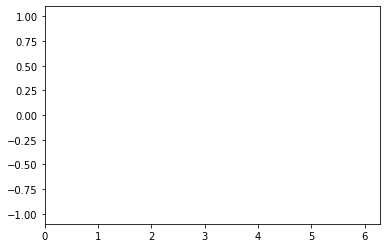

In [30]:
x = np.linspace(0, 2*np.pi, 100)
y = np.sin(x)

fig, ax = plt.subplots()
line, = ax.plot([])     # A tuple unpacking to unpack the only plot
ax.set_xlim(0, 2*np.pi)
ax.set_ylim(-1.1, 1.1)

def animate(frame_num):
    y = np.sin(x + 2*np.pi * frame_num/100)
    line.set_data((x, y))
    return line

anim = animation.FuncAnimation(fig, animate, frames=100, interval=20)
plt.show()

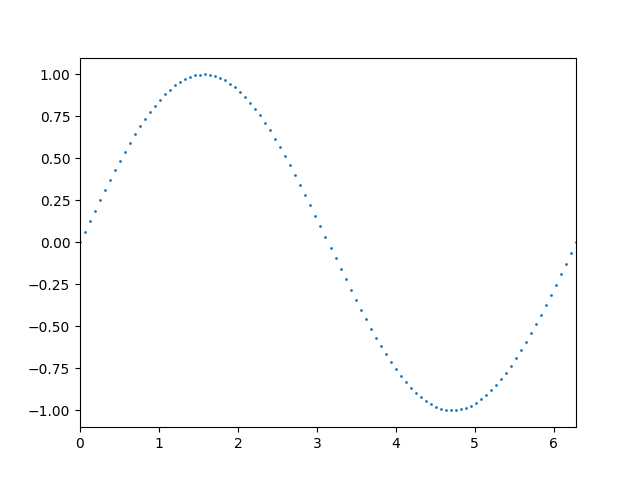

In [ ]:
x = np.linspace(0, 2*np.pi, 100)
y = np.sin(x)

fig, ax = plt.subplots()
scat = ax.scatter(x, y, s=1)     # A tuple unpacking to unpack the only plot
ax.set_xlim(0, 2*np.pi)
ax.set_ylim(-1.1, 1.1)

def animate(frame_num):
    y = np.sin(x + 2*np.pi * frame_num/100)
    scat.set_offsets(np.c_[x, y])
    return scat

anim = animation.FuncAnimation(fig, animate, frames=100, interval=20)
plt.show()

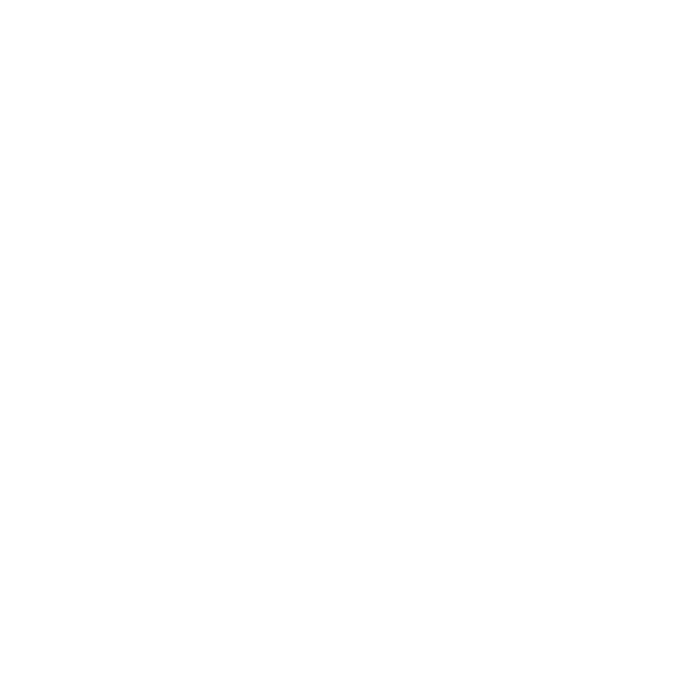

Unhandled message type set_device_pixel_ratio. {'device_pixel_ratio': 1.5, 'type': 'set_device_pixel_ratio'}


In [ ]:
# Fixing random state for reproducibility
np.random.seed(19680801)


# Create new Figure and an Axes which fills it.
fig = plt.figure(figsize=(7, 7))
ax = fig.add_axes([0, 0, 1, 1], frameon=False)
ax.set_xlim(0, 1), ax.set_xticks([])
ax.set_ylim(0, 1), ax.set_yticks([])

# Create rain data
n_drops = 50
rain_drops = np.zeros(n_drops, dtype=[('position', float, (2,)),
                                      ('size',     float),
                                      ('growth',   float),
                                      ('color',    float, (4,))])

# Initialize the raindrops in random positions and with
# random growth rates.
rain_drops['position'] = np.random.uniform(0, 1, (n_drops, 2))
rain_drops['growth'] = np.random.uniform(50, 200, n_drops)

# Construct the scatter which we will update during animation
# as the raindrops develop.
scat = ax.scatter(rain_drops['position'][:, 0], rain_drops['position'][:, 1],
                  s=rain_drops['size'], lw=0.5, edgecolors=rain_drops['color'],
                  facecolors='none')


def update(frame_number):
    # Get an index which we can use to re-spawn the oldest raindrop.
    current_index = frame_number % n_drops

    # Make all colors more transparent as time progresses.
    rain_drops['color'][:, 3] -= 1.0/len(rain_drops)
    rain_drops['color'][:, 3] = np.clip(rain_drops['color'][:, 3], 0, 1)

    # Make all circles bigger.
    rain_drops['size'] += rain_drops['growth']

    # Pick a new position for oldest rain drop, resetting its size,
    # color and growth factor.
    rain_drops['position'][current_index] = np.random.uniform(0, 1, 2)
    rain_drops['size'][current_index] = 5
    rain_drops['color'][current_index] = (0, 0, 0, 1)
    rain_drops['growth'][current_index] = np.random.uniform(50, 200)

    # Update the scatter collection, with the new colors, sizes and positions.
    scat.set_edgecolors(rain_drops['color'])
    scat.set_sizes(rain_drops['size'])
    scat.set_offsets(rain_drops['position'])


# Construct the animation, using the update function as the animation director.
anima = animation.FuncAnimation(fig, update, frames=120, interval=20)
plt.show()

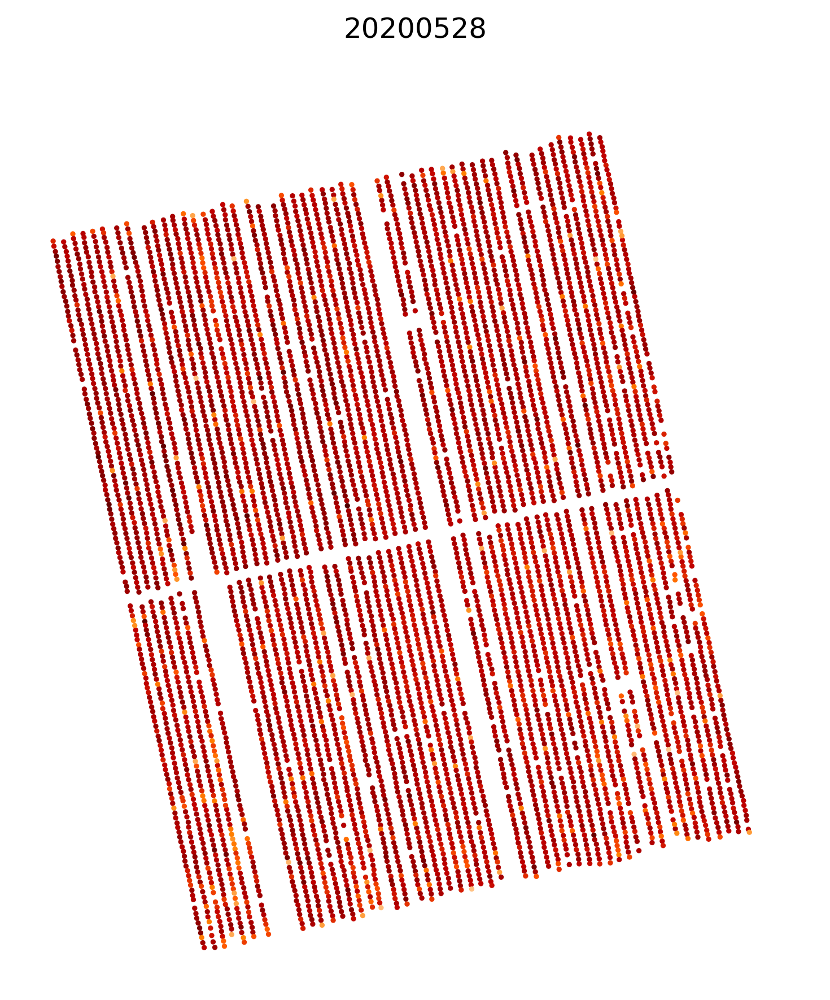

In [44]:
fig, ax = plt.subplots(1,1, figsize=(5,6), dpi=300)

# (48.10360499995295, 56.515635000076145, 28.741119999962393, 53.19332000007853)

ax.set(xlim=(0, 50), ylim=(0, 60))

sc = ax.scatter([0,50], [0, 60], marker='.', c=[0,30], s=20, edgecolors='None', cmap="gist_heat_r", vmin=0, vmax=32)

ax.set_title("aaaa")

def animate(i):
    i = i // (24*3)
    test_uav = uav_data20_merge[uav_data20_merge.date==date20[i]]

    sc.set_offsets(np.c_[test_uav.x, test_uav.y])
    sc.set_array(test_uav.major_axis_length/10)

    ax = plt.gca()
    ax.set_title(date20[i])

    return sc

ax.axis('equal')
ax.axis('off')

ani = animation.FuncAnimation(
    fig, animate, frames=6*24*3, interval=20, save_count=50)

plt.tight_layout()

ani.save('out/filename20.mp4')

plt.show()

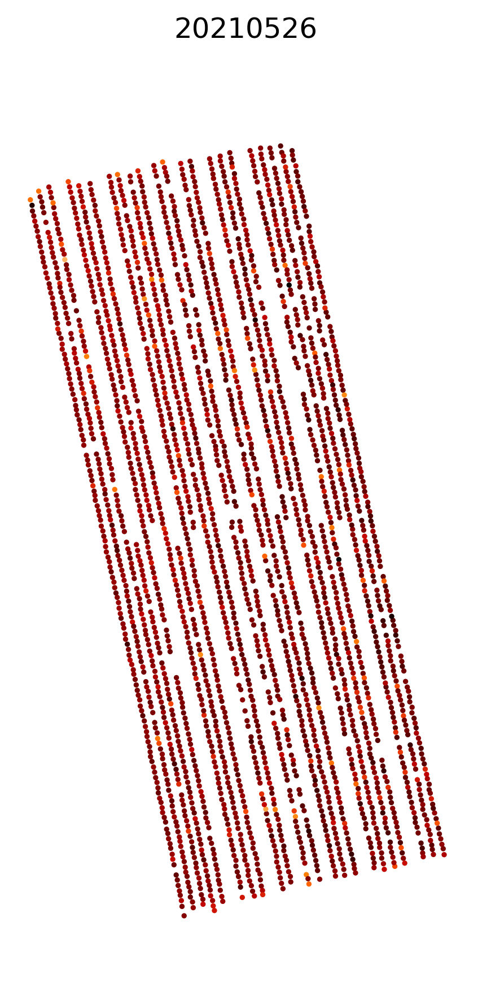

In [47]:
fig, ax = plt.subplots(1,1, figsize=(3,6), dpi=300)

# (48.10360499995295, 56.515635000076145, 28.741119999962393, 53.19332000007853)

ax.set(xlim=(0, 30), ylim=(0, 55))

sc = ax.scatter([0,30], [0, 55], marker='.', c=[0,30], s=20, edgecolors='None', cmap="gist_heat_r", vmin=0, vmax=32)

ax.set_title("aaaa")

def animate(i):
    i = i // (24*3)
    test_uav = uav_data21_merge[uav_data21_merge.date==date21[i]]

    sc.set_offsets(np.c_[test_uav.x, test_uav.y])
    sc.set_array(test_uav.major_axis_length/10)

    ax = plt.gca()
    ax.set_title(date21[i])

    return sc

ax.axis('equal')
ax.axis('off')

ani = animation.FuncAnimation(
    fig, animate, frames=6*24*3, interval=20, save_count=50)

plt.tight_layout()

ani.save('out/filename21.mp4')

plt.show()